# Introdução ao Uso do Sage para Modelagem Matemática

**Flávio Codeço Coelho -- Escola de Matemática Aplicada -- Fundação Getulio Vargas**

Nesta planilha  iremos apresentar algumas características básicas do Sage, com especial atenção ao uso para modelagem matemática. Vários dos exemplos mostrados aqui foram retirados do tutorial do Sage. Para um maior aprofundamento, recomendo a sua leitura.

## Linguagem de programação(s)

A linguagem básica para programação no Sage é o Python. 

Este tutorial também assume que o leitor tenha conhecimentos básicos de Python. Apenas introduziremos aspectos da linguagem do Sage onde houver construções sintáticas não compatíveis com o Python, como por exemplo:

In [1]:
3^2 == 3**2  # Isto não é verdadeiro em Python!

True

O Sage també é capaz de renderizar expressões matemáticas usando $\LaTeX$. Para ativar esta renderização:

In [2]:
%display typeset

A divisão também é um pouco diferente no Sage:

In [3]:
5/2 *1/3

5/6

O Sage procura retornar expressões exatas sempre que possível.

In [4]:
sin(pi/3)

1/2*sqrt(3)

Para aproximações numéricas use a função n(<expr>).

In [5]:
n(sin(pi/3))

0.866025403784439

In [6]:
type(sin(10))

<type 'sage.symbolic.expression.Expression'>

In [7]:
x = sin(10)
x

sin(10)

In [8]:
sin(10).n(digits=5)

-0.54402

In [9]:
print(n(pi^2))
pi.n(prec=128)  # Precisão em bits.

9.86960440108936


3.1415926535897932384626433832795028842

O Sage também introduz tipos extendidos, por exemplo:

In [10]:
a = 5/3  # Agora a é um número racional
print(type(a))
a.denominator()

<type 'sage.rings.rational.Rational'>


3


## Álgebra e Cálculo

O ponto forte to Sage é a computação simbólica. Vamos ver alguns exemplos.
### Manipulando Expressões Simbólicas

Vamos construir uma expressão simples:


In [11]:
var('x y')
z = (x+y)^3
z

(x + y)^3

In [12]:
type(z)

<type 'sage.symbolic.expression.Expression'>

Vamos expandir este binômio

In [13]:
expand(z)

x^3 + 3*x^2*y + 3*x*y^2 + y^3

Agora façamos o caminho de volta:

In [15]:
factor(expand(z))
#show(expand(z))

(x + y)^3

O sage também nos permite fazer matemática de forma mais interativa:

In [16]:
y = var('y') # Definindo y como uma variável simbólica também
@interact
def binomios(n=(2,9,1)): # n varia de 2 a 9 em intervalos de 1
    z = (x+y)^n
    show(expand(z))

SW50ZXJhY3RpdmUgZnVuY3Rpb24gPGZ1bmN0aW9uIGJpbm9taW9zIGF0IDB4N2Y3N2YxNTlhMjMwPiB3aXRoIDEgd2lkZ2V0CiAgbjogSW50U2xpZGVyKHZhbHVlPTUsIGRlc2NyaXB0aW9uPXXigKY=


Vamos brincar com algo um pouquinho mais complexo:

In [17]:
z = ((x - 1)^(3/2) - (x + 1)*sqrt(x - 1))/sqrt((x - 1)*(x + 1))
z

-((x + 1)*sqrt(x - 1) - (x - 1)^(3/2))/sqrt((x + 1)*(x - 1))

Podemos simplificar a expressão:

In [18]:
z.simplify_full()

-2*sqrt(x - 1)/sqrt(x^2 - 1)


## Resolvendo Equações

Para  fazer operações com símbolos, é sempre necessário informar ao sage que variáveis devem ser tratadas como símbolos ao invés de variáveis comuns. O símbolo $x$ é tratado como variável simbólica, por padrão, a menos que lhe seja atribuído um valor.


In [19]:
solve(x^2==-1,x)

[x == -I, x == I]

In [20]:
solve(x^2 + 3*x + 2, x)

[x == -2, x == -1]

Vários símbolos podem ser declarados simultâneamente. Isto é útil quando desejamos resolver uma equação sem especificar os coeficientes.

In [21]:
a, b, c = var('a b c')
solve([a*x^2 + b*x + c],x)

[x == -1/2*(b + sqrt(b^2 - 4*a*c))/a, x == -1/2*(b - sqrt(b^2 - 4*a*c))/a]

Também podemos resolver sistemas de equações.

In [36]:
x, y = var('x y')
solve([x+y==6, x-y==4], x, y)

[[x == 5, y == 1]]



Note o uso do sinal de == para espressar uma igualdade algébrica.

## Resolvendo Equações Numericamente

Às vezes solve não encontra uma solução para uma dada equação ou sistema de equações, nestes casos podemo buscar aproximações numéricas por meio da função `find_root`.


In [22]:
theta = var('theta')
solve(cos(theta)==sin(theta), theta)

[sin(theta) == cos(theta)]

Podemos verificar a existência da solução gráficamente:

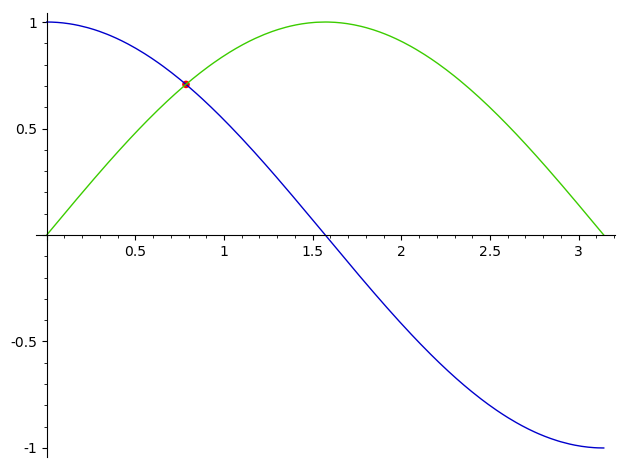

In [38]:
p = plot([cos(theta),sin(theta)], (theta, 0, pi))
q = point2d((0.785398163397,cos(0.785398163397)),color='red', size=30)
show(p+q)

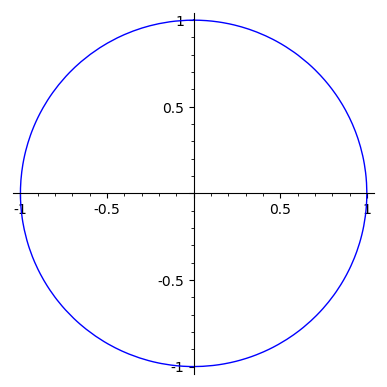

In [23]:
parametric_plot([sin(theta),cos(theta)],(theta, 0, 2*pi))


## Cálculo
### Diferenciação e Integração

Vamos começar com uma derivada simples.


In [24]:
var('u')
diff(sin(u), u)

cos(u)

Agora a quarta derivada de $sin(x^2)$

In [25]:
diff(sin(x^2), x, 4)

16*x^4*sin(x^2) - 48*x^2*cos(x^2) - 12*sin(x^2)

Derivadas parciais também não são problema:

In [26]:
x, y = var('x,y')
f = x^2 + 17*y^2
f.diff(x)

2*x

In [27]:
f.diff(y)

34*y

### Integrais indefinidas e definidas

$$\int x sin(x^2) dx$$

In [28]:
integral(x/(x^2+1), x, 0, 1)

1/2*log(2)

Decomposição por frações parciais de $\frac{1}{x^2-1}$

In [29]:
f = 1/(x^2-1)
f.partial_fraction(x)

-1/2/(x + 1) + 1/2/(x - 1)

## Plotando Funções

In [30]:
f(x)=x^3+1
P=plot(f,(x,-1,1))

Como o objeto "plot" foi atribuído a uma variável, nehuma saída gráfica é gerada. Antes de visualizarmos este gráfico, vamos gerar outro e aprender como visualizar multiplos gráficos combinados.

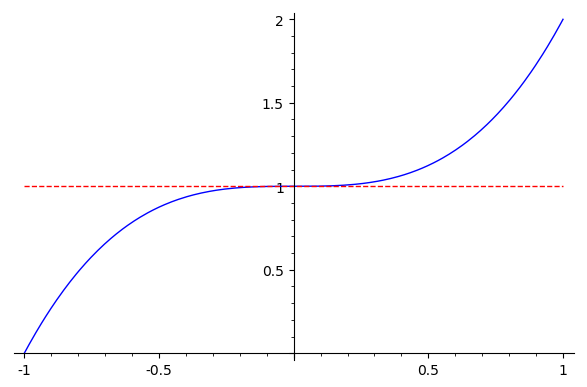

In [31]:
Q=plot(1,(x,-1,1),color="red", linestyle="--")
P+Q

Podemos modificar atributos do gráfico, para por exemplo, examinar mais de perto uma região:

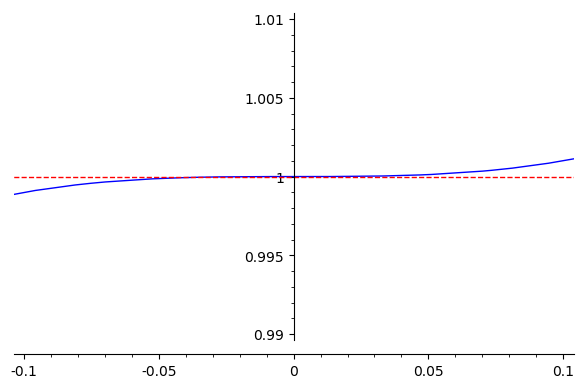

In [32]:
(P+Q).show(xmin=-.1,xmax=.1,ymin=.99,ymax=1.01)

Podemos também adicionar nomes aos eixos e adicionar legendas.

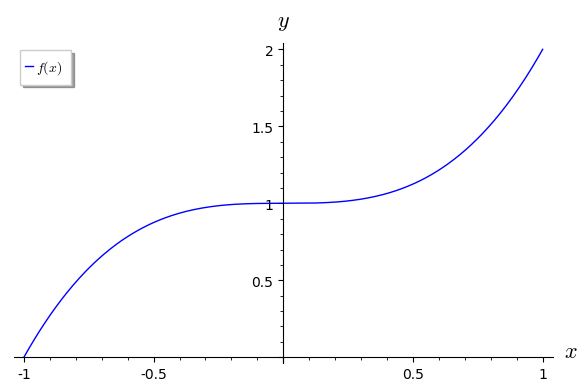

In [33]:
plot(f,(x,-1,1),axes_labels=['$x$','$y$'],legend_label='$f(x)$',show_legend=True)

Como já percebemos a escala do gráfico é ajustada automáticamente, logo, funções que vão para infinito sao melhor visualizadas com limites explícitos:

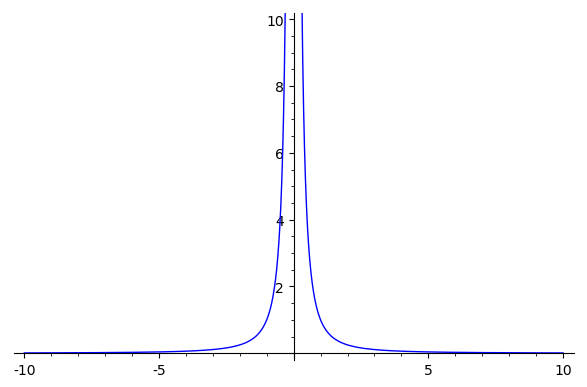

In [34]:
plot(1/x^2,(x,-10,10),ymax=10)

Outra excelente ferramenta de exploração matemática do Sage, são as funções interativas.

In [35]:
@interact
def plot_example(f=sin(x^2),r=range_slider(-5,5,step_size=0.25,default=(-3,3)),
                   color=color_selector(widget='colorpicker'),
                   thickness=(3,(1..10)),
                   adaptive_recursion=(5,(0..10)), adaptive_tolerance=(0.01,(0.001,1)),
                   plot_points=(20,(1..100)),
                   linestyle=['-','--','-.',':'],
                   gridlines=False, fill=False,
                   frame=False, axes=True
                   ):
      show(plot(f, (x,r[0],r[1]), color=color, thickness=thickness,
                   adaptive_recursion=adaptive_recursion,
                   adaptive_tolerance=adaptive_tolerance, plot_points=plot_points,
                   linestyle=linestyle, fill=fill if fill else None),
                   gridlines=gridlines, frame=frame, axes=axes)

SW50ZXJhY3RpdmUgZnVuY3Rpb24gPGZ1bmN0aW9uIHBsb3RfZXhhbXBsZSBhdCAweDdmNzdlYWU2OTUwMD4gd2l0aCAxMiB3aWRnZXRzCiAgZjogRXZhbFRleHQodmFsdWU9dSdzaW4oeF4yKSfigKY=


Podemos também fazer gráficos em três dimensões:

In [36]:
g(x,y)=sin(x^2+y^2)
plot3d(g,(x,-5,5),(y,-5,5), plot_points=300)

Graphics3d Object

Também podemos sobrepor gráficos tridimensionais:

In [57]:
b = 2.2
P=plot3d(sin(x^2-y^2),(x,-b,b),(y,-b,b), opacity=.7)
Q=plot3d(0, (x,-b,b), (y,-b,b), color='red')
P+Q

Graphics3d Object

Agora um gráfico mais interessante: Um gráfico implícito!

In [58]:
var('x,y,z')
T = golden_ratio
p = 2 - (cos(x + T*y) + cos(x - T*y) + cos(y + T*z) + cos(y - T*z) + cos(z - T*x) + cos(z + T*x))
r = 4.78
implicit_plot3d(p, (x, -r, r), (y, -r, r), (z, -r, r), plot_points=100, color='yellow')

Graphics3d Object